# Emergency Calls

This notebook has been created to practice data visualization. <br />
The dataset is from Kaggle(https://www.kaggle.com/mchirico/montcoalert/metadata).


## Exploring Data
First, let's import what we need.

In [3]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns;
import folium

Now, let's read data from 911.csv.

In [4]:
import datetime
# emergencyCalls = pd.read_csv('./911.csv', sep=",")
dateparse = lambda x: datetime.datetime.strptime(x,'%Y-%m-%d %H:%M:%S')

# Read data 
emergencyCalls = pd.read_csv('./911.csv',
    header=0,names=['lat', 'lng','desc','zip','title','timeStamp','twp','addr','e'],
    dtype={'lat':str,'lng':str,'desc':str,'zip':str,
                  'title':str,'timeStamp':str,'twp':str,'addr':str,'e':int}, 
     parse_dates=['timeStamp'],date_parser=dateparse)

### Data Features

Let's take a look at our 5 top data.<br/>


In [5]:
emergencyCalls.head()

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.2978759,-75.5812935,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.2580614,-75.2646799,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1
2,40.1211818,-75.3519752,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1
3,40.1161530,-75.3435130,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1
4,40.2514920,-75.6033497,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1


### Which features are available in the dataset?
Features:
* lat: latitude of where they need help
* lng: langitude of where they neeed help
* desc: station information and time it recieved the call
* zip: zipcode
* title: category of emergency 
* timeStamp: when the call was recieved
* twp: township
* addr: address

In [14]:
emergencyCalls.columns
emergencyCalls.dtypes

lat                       object
lng                       object
desc                      object
zip                       object
title                     object
timeStamp         datetime64[ns]
twp                       object
addr                      object
e                          int64
emergencyType             object
detailedReason            object
dtype: object

### How many rows and columns does the dataset have?

This question simply asks the shape of our data, we can see we have 663522 rows and 9 columns.

In [7]:
emergencyCalls.shape

(663522, 9)

### Which features contain blank, null or empty values?
We can see some of zipcodes and townships are missing.

In [8]:
emergencyCalls.isnull().any()

lat          False
lng          False
desc         False
zip           True
title        False
timeStamp    False
twp           True
addr         False
e            False
dtype: bool

### How many zip codes does the dataset have?
We count unique zipcode and we exclude NaN by passing dropna=True to nunique function. We have 204 different zipcodes.


In [9]:
emergencyCalls['zip'].nunique(dropna=True)

204

### Expand title column
As you can see the title column include an emergency type followed by a more specific tag of the emergency. For easier analyzing we can add two columns and split the type and detailed reason.

In [10]:
emergencyCalls['emergencyType'] = emergencyCalls['title'].apply(lambda title: title.split(":")[0])
emergencyCalls['detailedReason'] = emergencyCalls['title'].apply(lambda title: title.split(":")[1])

## Visualizing Data
Let's start by visualizing frequency of emergency types. You can see most of calls are recieved because of EMS, second reason is traffic, and least emergency occurence is related to fire.   

Text(0.5, 1.0, 'Frequency of different emergency types')

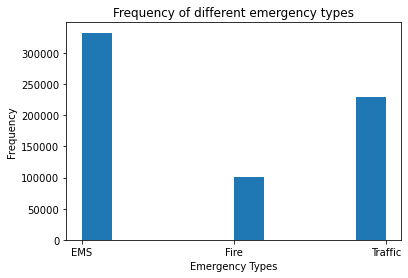

In [11]:
plt.hist(emergencyCalls['emergencyType'])
plt.xlabel('Emergency Types')
plt.ylabel('Frequency')
plt.title('Frequency of different emergency types')

### Detailed EMS Calls

We can see there are 81 different reason for EMS calls.

In [12]:
EMSFilter = (emergencyCalls['emergencyType'] == 'EMS')
EMSCalls = emergencyCalls[EMSFilter]
EMSCalls['detailedReason'].nunique()

81

Here, we can see top 10 categories of medical emergencies.

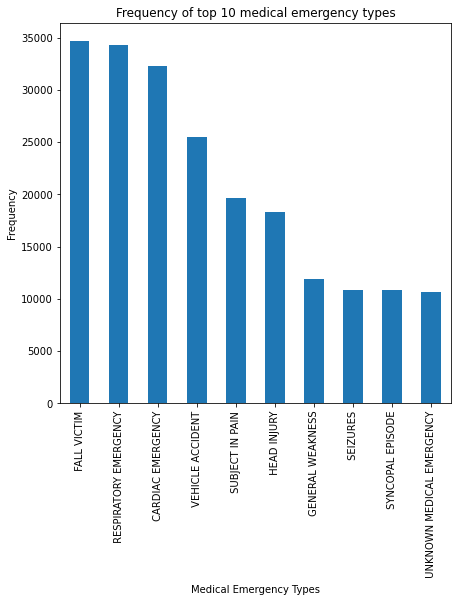

In [15]:
plt.figure(figsize=(7,7))
plt.xlabel('Medical Emergency Types')
plt.ylabel('Frequency')
plt.title('Frequency of top 10 medical emergency types')
EMSCalls['detailedReason'].value_counts().nlargest(10).plot(kind='bar')

### Detailed Fire Related Calls
We can see there are 60 different reasons for fire related calls.

In [16]:
fireFilter = (emergencyCalls['emergencyType'] == 'Fire')
fireCalls = emergencyCalls[fireFilter]
fireCalls['detailedReason'].nunique()

60

Here, we can see top 5 categories of fire related calls.

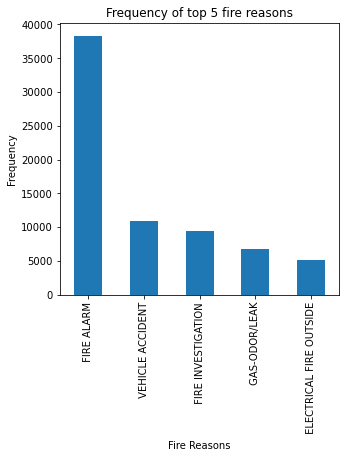

In [17]:
plt.figure(figsize=(5,5))
plt.xlabel('Fire Reasons')
plt.ylabel('Frequency')
plt.title('Frequency of top 5 fire reasons')
fireCalls['detailedReason'].value_counts().nlargest(5).plot(kind='bar')

### Detailed Traffic Related Calls
We can see there are 7 different reasons for traffic related calls.

In [18]:
trafficFilter = (emergencyCalls['emergencyType'] == 'Traffic')
trafficCalls = emergencyCalls[trafficFilter]
trafficCalls['detailedReason'].nunique()

7

Here, we can see top 5 categories of traffic related calls.

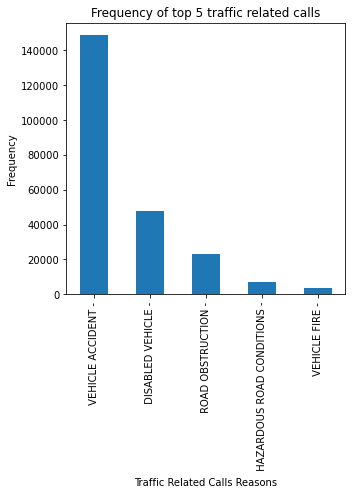

In [19]:
plt.figure(figsize=(5,5))
plt.xlabel('Traffic Related Calls Reasons')
plt.ylabel('Frequency')
plt.title('Frequency of top 5 traffic related calls')
trafficCalls['detailedReason'].value_counts().nlargest(5).plot(kind='bar')

### Hazardous road conditions and vehicle accidents

In this section, we visualize locations with reported hazardous road conditions(Traffic-HAZARDOUS ROAD CONDITIONS) 
and locations with reported vehicle accidents that needed medical services(EMS-VEHICLE ACCIDENT). 
Locations with hazardous conditions are shown in red 
and locations with reported vehicle accidents that needed medical services are shown in blue.
It seems hazardous road conditions can cause accidents!

In [20]:
traffic = (emergencyCalls['emergencyType'] == 'Traffic')
hazardous = (emergencyCalls['detailedReason'] == ' HAZARDOUS ROAD CONDITIONS -')
filt1 = (traffic & hazardous)
hazardousRoads = emergencyCalls[filt1]
EMS = (emergencyCalls['emergencyType'] == 'EMS')
accident = (emergencyCalls['detailedReason'] == ' VEHICLE ACCIDENT')
filt2 = (EMS & accident)
accidentLocations = emergencyCalls[filt2]

In [21]:
m = folium.Map(location=[40.292431, -75.47832], tiles='Stamen Toner', zoom_start=30)
for i in range(0,len(hazardousRoads)):
    folium.Circle(
      location=[hazardousRoads.iloc[i]['lat'], hazardousRoads.iloc[i]['lng']],
      popup=hazardousRoads.iloc[i]['addr'],
      radius=10,
      color='crimson',
      fill=True,
      fill_color='crimson'
   ).add_to(m)
    
for i in range(0,len(accidentLocations)):
    folium.Circle(
      location=[accidentLocations.iloc[i]['lat'], accidentLocations.iloc[i]['lng']],
      popup=accidentLocations.iloc[i]['addr'],
      radius=10,
      color='blue',
      fill=False,
      fill_color='blue'
   ).add_to(m)



In [22]:
# please check out plot_data.html to see this visualization
m.save('plot_data.html')

In [33]:
m

### Recieved calls heatmap

We can see the heatmap of calls based on day hour and month.

In [29]:
emergencyCalls['month'] = pd.to_datetime(emergencyCalls['timeStamp']).dt.month
emergencyCalls['hour'] = pd.to_datetime(emergencyCalls['timeStamp']).dt.hour

In [30]:
table = pd.pivot_table(emergencyCalls, values='e', index=['month'], columns=['hour'], aggfunc=np.sum)
table

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
month,,,,,,,,,,,,,,,,,,,,,
1,1308,1051,1056,969,962,1129,1891,2706,3551,3441,...,3629,3709,3678,4171,3535,2985,2467,2180,1829,1550
2,1163,996,873,756,827,1011,1567,2525,2975,3044,...,3256,3441,3356,3284,3221,2806,2343,2053,1760,1466
3,1275,1086,978,870,805,1072,1530,2405,3030,3229,...,3740,3999,3979,3882,3092,3011,2629,2291,1796,1468
4,1051,946,825,714,792,870,1417,2189,2663,2887,...,3310,3489,3616,3440,3018,2513,2293,1919,1640,1338
5,1198,988,871,834,805,905,1481,2364,2807,3085,...,3519,3765,3881,3854,3170,2725,2571,2211,1757,1428
6,1244,1003,926,801,759,1093,1470,2284,2769,3038,...,3780,3871,4169,3955,3317,2865,2495,2311,1938,1596
7,1244,1142,972,894,863,1080,1366,1983,2718,3163,...,3750,3767,3813,4075,3494,3110,2669,2510,1923,1489
8,1019,849,844,697,671,835,1117,1890,2383,2509,...,3020,3183,3148,3119,2577,2226,2138,1825,1449,1218
9,1015,864,794,685,625,840,1205,2068,2418,2643,...,2800,2945,3056,3095,2536,2361,2076,1744,1426,1201


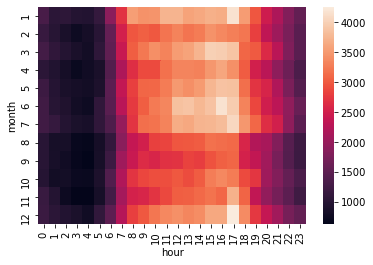

In [31]:
sns.heatmap(table)

In [32]:
pd.to_datetime(emergencyCalls['timeStamp']).dt.year.describe()

count    663522.000000
mean       2017.766131
std           1.335193
min        2015.000000
25%        2017.000000
50%        2018.000000
75%        2019.000000
max        2020.000000
Name: timeStamp, dtype: float64